# Considering Churn Drivers

In the previous task, we found a few features that could be possible drivers for customer attrition. Those features were electricity consumption over the past 12 months, `cons_12m`, gas consumption over the past 12 months, `cons_gas_12m`, net margin on power subscription, `margin_net_pow_ele`, and subscribed power, `pow_max`.

Other features that could help predict churn are:

1. `activity_new`: category of the company's activity
2. `channel_sales`: code of the sales channel
3. `imp_cons`: current paid consumption 
4. `origin_up`: code of the electricity campaign the customer first subscribed to
5. `price_p3_fix`: price of power for the third period

Reasoning:

1. If most customers churn because of a certain activity category, perhaps that will help in prediction.
2. Same reasoning as 1. but for channel sales.
3. Intuitively, churners will have paid less in consumption than non-churners because they are no longer clients.
4. Same reasoning as 1. but for electricity campaign.
5. The price of power seems reasonable to have an affect on churn.

Feature selection and engineering is an iterative process. You will never have all the features to perfectly predict something, which is why it is very important to experiment different features.

# Getting Started

In [ ]:
# Load libraries
import pandas as pd
import numpy as np
import datetime as dt

import matplotlib.pyplot as plt
import seaborn as sns

from yellowbrick.regressor import CooksDistance

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA

# Set up
%matplotlib inline
sns.set()

# Format output numbers
pd.set_option('display.float_format', lambda x: '%.3f' % x)

: 

In [4]:
# Load data
data = pd.read_pickle('BCG_data_cleaned.pickle')

# Drop id and date columns since it does not help with predictions
to_drop = [col for col in data.columns if data[col].dtype == 'datetime64[ns]']
to_drop.append('id')
data.drop(to_drop, axis=1, inplace=True)

# Preprocessing

## Encoding Categorical Features

We dropped the date features assuming they do not contribute to model predictions.

In [5]:
pd.DataFrame({'Data Types': data.dtypes})

,Data Types
activity_new,object
channel_sales,object
cons_12m,int64
cons_gas_12m,int64
cons_last_month,int64
forecast_cons_12m,float64
forecast_cons_year,int64
forecast_discount_energy,float64
forecast_meter_rent_12m,float64
forecast_price_energy_p1,float64


Before we model, we need all our features to be numerical. We can encode our features with type object using `pd.get_dummies` or `OneHotEncoder` from the `sklearn.preprocessing` library. We will use the built-in pandas function.

In [6]:
# Get object columns
to_convert = [col for col in data.columns if data[col].dtype == 'object']

# Convert to type category
data[to_convert] = data[to_convert].apply(lambda x: x.astype('category'))

# Conversion confirmation
for col in to_convert:
    assert data[col].dtype == 'category'

In [7]:
data.activity_new.value_counts()

missing                             110557
apdekpcbwosbxepsfxclislboipuxpop     18163
kkklcdamwfafdcfwofuscwfwadblfmce      5011
kwuslieomapmswolewpobpplkaooaaew      2695
fmwdwsxillemwbbwelxsampiuwwpcdcb      2540
                                     ...  
kllldxcildwkssbmoabmsdffmawsafsf        11
laslwixpcspcffiadlfkeosicpsuaboc        11
disxkufseacaikoobdmfomdsbcxmocae        11
wkwdccuiboaeaalcaawlwmldiwmpewma        11
dbklukmppmseoekmmxfolmfbdidmawls        10
Name: activity_new, Length: 418, dtype: int64

If we were to convert this feature into dummy variables, we would have 417 columns (drop one to avoid dummy variable trap). What we can do instead is replace all activity codes with less than 100 counts as "missing". The same will be done for `channel_sales` or `origin_up` if needed.

In [8]:
# Activity feature
activities = pd.DataFrame({'Activity New':data.activity_new.value_counts()})
to_replace = activities[activities['Activity New'] < 100].index.tolist()

# Replace activity counts less than 100
data['activity_new'] = data.activity_new.replace(to_replace, 'missing')

In [9]:
pd.DataFrame({'Channel Sales':data.channel_sales.value_counts()})

,Channel Sales
foosdfpfkusacimwkcsosbicdxkicaua,84467
missing,49442
lmkebamcaaclubfxadlmueccxoimlema,24261
usilxuppasemubllopkaafesmlibmsdf,16790
ewpakwlliwisiwduibdlfmalxowmwpci,11215
sddiedcslfslkckwlfkdpoeeailfpeds,118
epumfxlbckeskwekxbiuasklxalciiuu,48


In [10]:
pd.DataFrame({'Origin Up':data.origin_up.value_counts()})

,Origin Up
lxidpiddsbxsbosboudacockeimpuepw,90150
kamkkxfxxuwbdslkwifmmcsiusiuosws,53394
ldkssxwpmemidmecebumciepifcamkci,42763
usapbepcfoloekilkwsdiboslwaxobdp,22
ewxeelcelemmiwuafmddpobolfuxioce,12


Only seven categories in the `channel_sales` feature and five in 'origin_up`. Now we can convert all three into a dummy dataframe.

In [11]:
# Convert activities to dummies
activity_dummy = pd.get_dummies(data.activity_new, prefix='activ', drop_first=True)

# Shorten column names
activity_dummy.columns = [col[:10] for col in activity_dummy.columns]
display(activity_dummy.head())


# Convert channels to dummies
channel_dummy = pd.get_dummies(data.channel_sales, prefix='channel', drop_first=True)

# Shorten column names
channel_dummy.columns = [col[:12] for col in channel_dummy.columns]
display(channel_dummy.head())


# Convert origin to dummies
origin_dummy = pd.get_dummies(data.origin_up, prefix='origin', drop_first=True)

# Shorten column names
origin_dummy.columns = [col[:11] for col in origin_dummy.columns]
display(origin_dummy.head())

,activ_acpm,activ_afec,activ_akok,activ_alku,activ_alml,activ_apde,activ_apmp,activ_awox,activ_axek,activ_axsu,...,activ_wdkx,activ_wixk,activ_wlxf,activ_wxem,activ_xbsb,activ_xcsw,activ_xkfp,activ_xlpu,activ_xpma,activ_xwws
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


,channel_ewpa,channel_foos,channel_lmke,channel_miss,channel_sddi,channel_usil
0,0,0,1,0,0,0
1,0,0,1,0,0,0
2,0,0,1,0,0,0
3,0,0,1,0,0,0
4,0,0,1,0,0,0


,origin_kamk,origin_ldks,origin_lxid,origin_usap
0,0,1,0,0
1,0,1,0,0
2,0,1,0,0
3,0,1,0,0
4,0,1,0,0


Now that our categorical features have been numerically encoded, we can merge all three datasets into our main `data` dataframe and drop the original features.

In [12]:
# Merge datasets
for df in [activity_dummy, channel_dummy, origin_dummy]:
    data = pd.merge(data, df, left_index=True, right_index=True)

data.drop(['activity_new', 'channel_sales', 'origin_up'], axis=1, inplace=True)

In [13]:
pd.DataFrame({'Data Types':data.dtypes})

,Data Types
cons_12m,int64
cons_gas_12m,int64
cons_last_month,int64
forecast_cons_12m,float64
forecast_cons_year,int64
...,...
channel_usil,uint8
origin_kamk,uint8
origin_ldks,uint8
origin_lxid,uint8


## Outliers

Since we decided in using logistic regression in the first task as a baseline, we will need to remove influential outliers. Influential outliers are considered extreme outliers. In order to detect these extreme outliers, we can use Cook's Distance. Generally, a rule for flagging influential outliers is when Cook's Distance is greater than 4/n, where n is the number of observations.

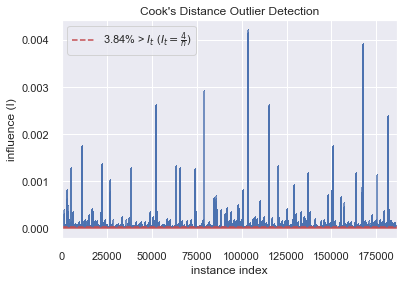

<AxesSubplot:title={'center':"Cook's Distance Outlier Detection"}, xlabel='instance index', ylabel='influence (I)'>

In [15]:
X = data.iloc[:,:24]
y = data.churn

cd = CooksDistance()
cd.fit(X, y)
cd.show()
# LEFT OFF HERE #

In [125]:
# Basic statistics on non-dummy variables
data.iloc[:,:24].describe()

,cons_12m,cons_gas_12m,cons_last_month,forecast_cons_12m,forecast_cons_year,forecast_discount_energy,forecast_meter_rent_12m,forecast_price_energy_p1,forecast_price_energy_p2,forecast_price_pow_p1,...,nb_prod_act,net_margin,num_years_antig,pow_max,price_p1_var,price_p2_var,price_p3_var,price_p1_fix,price_p2_fix,price_p3_fix
count,186341.000,186341.000,186341.000,186341.000,186341.000,186341.000,186341.000,186341.000,186341.000,186341.000,...,186341.000,186341.000,186341.000,186341.000,186341.000,186341.000,186341.000,186341.000,186341.000,186341.000
mean,191334.140,31295.103,19315.957,2351.001,1903.996,0.974,70.284,0.136,0.053,43.524,...,1.349,217.200,5.055,20.440,0.141,0.054,0.031,43.322,10.678,6.453
std,672227.793,171618.301,82430.930,3982.709,5184.001,5.121,78.598,0.026,0.049,5.221,...,1.481,356.073,1.672,21.169,0.025,0.050,0.036,5.390,12.842,7.785
min,-125276.000,-3037.000,-91386.000,-16689.260,0.000,0.000,0.000,0.000,0.000,0.000,...,1.000,-4148.990,1.000,1.000,0.000,0.000,0.000,0.000,0.000,0.000
25%,5889.000,0.000,0.000,512.790,0.000,0.000,16.230,0.115,0.000,40.607,...,1.000,52.020,4.000,12.500,0.126,0.000,0.000,40.729,0.000,0.000
50%,15209.000,0.000,902.000,1177.420,381.000,0.000,19.440,0.143,0.086,44.311,...,1.000,119.460,5.000,13.856,0.146,0.085,0.000,44.267,0.000,0.000
75%,49492.000,0.000,4104.000,2673.280,1994.000,0.000,131.540,0.146,0.099,44.311,...,1.000,274.040,6.000,19.800,0.152,0.102,0.073,44.445,24.340,16.226
max,16097108.000,4154590.000,4538720.000,103801.930,175375.000,50.000,2411.690,0.274,0.196,59.445,...,32.000,24570.650,16.000,500.000,0.281,0.230,0.114,59.445,36.491,17.458


In [126]:
# Checking variation
data.iloc[:,:24].var().sort_values(ascending=False)

cons_12m                   451890206321.265
cons_gas_12m                29452841205.630
cons_last_month              6794858294.266
forecast_cons_year             26873866.518
forecast_cons_12m              15861972.496
imp_cons                         235312.409
net_margin                       126787.955
forecast_meter_rent_12m            6177.629
margin_net_pow_ele                  780.479
margin_gross_pow_ele                556.642
pow_max                             448.112
price_p2_fix                        164.914
price_p3_fix                         60.604
price_p1_fix                         29.052
forecast_price_pow_p1                27.263
forecast_discount_energy             26.223
num_years_antig                       2.795
nb_prod_act                           2.193
has_gas                               0.152
price_p2_var                          0.003
forecast_price_energy_p2              0.002
price_p3_var                          0.001
forecast_price_energy_p1        

Seems like the features that have to do anything with consumption have incredibly high variance. If we leave this as is, our model will not perform well since the data will not be in the same numerical space as with our dummy variables (since there are only two values, 0 and 1). We can fix this by log normalizing using the `np.log` function or sklearn's `StandardScaler`. We'll be using the latter since there are quite a few features whos values reach the negatives. As mentioned in the previous task, I am not sure if those features like `cons_12m` or `cons_gas_12m` can be negative. This is an example in where domain knowledge helps in analysis. Some other features may seem to have a high variance too however the order of magnitude allows us to not have to normalize them.

Another reason to scale our data is because PCA requires it. Otherwise, garbage in, garbage out.

In [127]:
scaler = StandardScaler()

# Features to scale
to_normalize = data.iloc[:,:24].columns.tolist()
data[to_normalize] = scaler.fit_transform(data[to_normalize])

In [128]:
print('There are {} columns in total.'.format(data.shape[1]))

There are 155 columns in total.


Our dataframe is almost ready, but we should attempt to reduce the number of features in order to avoid the risk of overfitting. Overfitting is when our model fits too perfectly on the training set and fails to generalize on new, unseen data. This can be identified when generating the scoring metrics. If the traing score is greater then the validation score, the model is perhaps overfit.

Our process for reducing the number of features is called Principle Component Analysis (PCA). PCA projects each data point onto principal components to reduce the number of features while preserving as much of the data's variation as possible. We will state the algorithm to use five components, and from there we should be able to decide on an optimal number of components.

In [129]:
# pca = PCA(n_components=5, random_state=42)

# Split into feature data and target label
X = data.drop('churn', axis=1)
y = data.churn

# Split data into training and validation sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# pca.fit_transform(X)
# principle_components = pca.fit_transform(X)
#pca.fit_transform(X_train)
#pca.fit_transform(X_train, y_train)

# display(
#     pd.DataFrame({'Explained Variance Ratio':np.cumsum(pca.explained_variance_ratio_)}))

# # Plot explained variance ratio
# plt.plot(pca.explained_variance_ratio_)
# plt.xlabel('Principal Component Index')
# plt.ylabel('Explained Variance Ratio')
# plt.show()

With just two components we are able to explain 95% of the variation. This allows us to drop all other unnecessary features that are not impactful.

In [132]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.pipeline import Pipeline

pipe = Pipeline([
    ('reducer', PCA(n_components=2, random_state=42)),
    ('clf', RandomForestClassifier(random_state=42))])

pipe.fit(X_train, y_train)

Pipeline(steps=[('reducer', PCA(n_components=2, random_state=42)),
                ('clf', RandomForestClassifier(random_state=42))])

In [133]:
from sklearn.metrics import accuracy_score

print(pipe.score(X_train, y_train))
print(pipe.score(X_test, y_test), '\n')

1.0
0.9932115162735786 



Note to self:
- Last left off on the above cell
- See if the score metric seems reasonable
    - Seems kinda sus the model performs so well

In [395]:
pca.components_

array([[ 1.70865128e-03,  2.23699791e-04,  3.26520068e-03,
        -9.99185950e-01, -4.82530185e-03, -3.52439998e-02,
         1.85660722e-02,  5.99034252e-06,  6.84577011e-06,
         6.21235796e-06, -5.12350623e-06,  7.86067090e-06,
         1.74759215e-04, -1.04211768e-06,  5.99203208e-06,
         1.42871490e-05, -4.45666073e-06, -1.86523199e-05,
        -4.80168706e-06, -1.21405069e-05,  1.37112791e-07,
         7.10247191e-06,  2.80967597e-06,  1.33808773e-05,
         8.84472650e-06,  5.37608981e-06, -1.26010344e-05,
        -7.01154414e-07, -6.35635656e-05, -2.77608935e-05,
         2.18265446e-05, -7.01511026e-07,  1.76187134e-05,
        -3.52360005e-06,  1.75130088e-05,  4.26688402e-07,
        -8.91223724e-06,  1.03912550e-06, -2.67751549e-06,
        -1.57075701e-05, -7.26008001e-06, -5.25323321e-06,
         4.88490424e-05, -2.10166548e-05, -8.69143013e-06,
         2.72845251e-05, -5.21059363e-06, -6.00966864e-06,
        -8.52200780e-06, -4.75706193e-06,  1.73616117e-0